# Data Path Settings

In [ ]:
USE_COLAB = True

In [ ]:
curren_dir = '/content/drive/MyDrive/PROJETO_IMAGEM/Weeds.v3-augmented_nottrained.tensorflow/'


In [ ]:
import os
os.getcwd()

'/content'

In [ ]:
import sys
if USE_COLAB:
    from google.colab import drive
    drive.mount('/content/drive/')
    sys.path.append(curren_dir) ## Place correct
else:
    sys.path.append('')

import numpy as np
import cv2
import os
from datetime import datetime

from PIL import Image

import torch
import torchvision

from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torch.utils.data import Dataset, DataLoader, Subset
import torchvision.transforms.functional as F

from sklearn.model_selection import train_test_split
from tqdm import tqdm

from matplotlib import pyplot as plt
import pickle

import pandas as pd
import glob as glob
import random

Mounted at /content/drive/


In [ ]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
print("We use the following device: ", device)
# load a model; pre-trained on COCO
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(weights='COCO_V1').to(device)

We use the following device:  cuda


Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100%|██████████| 160M/160M [00:02<00:00, 58.2MB/s]


In [ ]:
def img_transform(img):
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB).astype(np.float32)
  img /= 255.0
  img = torch.from_numpy(img).permute(2,0,1)
  return img

# Preprocessing

In [ ]:
def inference(img, model, detection_threshold=0.0):
  '''
  Infernece of a single input image

  inputs:
    img: input-image as torch.tensor (shape: [C, H, W])
    model: model for infernce (torch.nn.Module)
    detection_threshold: Confidence-threshold for NMS (default=0.7)

  returns:
    boxes: bounding boxes (Format [N, 4] => N times [xmin, ymin, xmax, ymax])
    labels: class-prediction (Format [N] => N times an number between 0 and _num_classes-1)
    scores: confidence-score (Format [N] => N times confidence-score between 0 and 1)
  '''
  model.eval()

  img = img.to(device)
  outputs = model([img])

  boxes = outputs[0]['boxes'].data.cpu().numpy()
  scores = outputs[0]['scores'].data.cpu().numpy()
  labels = outputs[0]['labels'].data.cpu().numpy()

  boxes = boxes[scores >= detection_threshold].astype(np.int32)
  labels = labels[scores >= detection_threshold]
  scores = scores[scores >= detection_threshold]

  return boxes, scores, labels

In [ ]:
import matplotlib.patches as patches

def plot_image(img, boxes, scores, labels, dataset, save_path=None):
  '''
  Function that draws the BBoxes, scores, and labels on the image.

  inputs:
    img: input-image as numpy.array (shape: [H, W, C])
    boxes: list of bounding boxes (Format [N, 4] => N times [xmin, ymin, xmax, ymax])
    scores: list of conf-scores (Format [N] => N times confidence-score between 0 and 1)
    labels: list of class-prediction (Format [N] => N times an number between 0 and _num_classes-1)
    dataset: list of all classes e.g. ["background", "class1", "class2", ..., "classN"] => Format [N_classes]
  '''

  cmap = plt.get_cmap("tab20b")
  class_labels = np.array(dataset)
  colors = [cmap(i) for i in np.linspace(0, 1, len(class_labels))]
  height, width, _ = img.shape
  # Create figure and axes
  fig, ax = plt.subplots(1, figsize=(16, 8))
  # Display the image
  ax.imshow(img)
  for i, box in enumerate(boxes):
    class_pred = labels[i]
    conf = scores[i]
    width = box[2] - box[0]
    height = box[3] - box[1]
    rect = patches.Rectangle(
        (box[0], box[1]),
        width,
        height,
        linewidth=2,
        edgecolor=colors[int(class_pred)],
        facecolor="none",
    )
    # Add the patch to the Axes
    ax.add_patch(rect)
    plt.text(
        box[0], box[1],
        s=class_labels[int(class_pred)] + " " + str(int(100*conf)) + "%",
        color="white",
        verticalalignment="top",
        bbox={"color": colors[int(class_pred)], "pad": 0},
    )

  # Used to save inference phase results
  if save_path is not None:
    plt.savefig(save_path)

  plt.show()

In [ ]:
df = pd.read_csv(sys.path[-1] + 'train/_annotations.csv')


In [ ]:
path_csv = sys.path[-1] + 'train/_annotations.csv'
img_dir = sys.path[-1] + 'train/'

In [ ]:
df = pd.read_csv(path_csv)
print("Number of total bounding boxes: ", len(df))

image_paths = glob.glob(f"{img_dir}/*.jpg")
all_images = [image_path.split(os.path.sep)[-1] for image_path in image_paths]
all_images = sorted(all_images)
print("Number of unique images: ", len(all_images))

Number of total bounding boxes:  9983
Number of unique images:  3684


In [ ]:
'''
Class that holds all the augmentation related attributes
'''
class Transformation():
    # This provides a random probability of the augmentation to be applied or not
    def get_probability(self):
        return np.random.choice([False, True], replace=False, p=[0.5, 0.5])

    # Increases the contrast by a factor of 2
    def random_adjust_contrast(self, image, enable=None):
        enable = self.get_probability() if enable is None else enable
        return F.adjust_contrast(image, 2) if enable else image

    # Increaes the brightness by a factor of 2
    def random_adjust_brightness(self, image, enable=None):
        enable = enable = self.get_probability() if enable is None else enable
        return F.adjust_brightness(image,2) if enable else image

    # Horizontal flip
    def random_hflip(self, image, boxes, enable=None):
        enable = enable = self.get_probability() if enable is None else enable
        if enable:
          #flip image
          new_image = F.hflip(image)

          #flip boxes
          new_boxes = boxes.clone()
          new_boxes[:, 0] = image.shape[2] - boxes[:, 0]  # image width - xmin
          new_boxes[:, 2] = image.shape[2] - boxes[:, 2]  # image_width - xmax
          new_boxes = new_boxes[:, [2, 1, 0, 3]]          # Interchange the xmin and xmax due to mirroring
          return new_image, new_boxes
        else:
          return image, boxes

In [ ]:
class vehicleDataset(Dataset):
  def __init__(self, img_path, label_path, classes, transforms=None):
    super().__init__()
    print("Preparing the dataset...")

    self.image_dir = img_path
    self.gt_info = pd.read_csv(label_path)
    self.classes = classes
    self.transforms = transforms

    # Create a list of image file names (in sorted order - this is optional)
    self.image_paths = glob.glob(f"{img_path}/*.jpg")
    all_images = [image_path.split(os.path.sep)[-1] for image_path in self.image_paths]
    self.all_images = sorted(all_images)

    # Map Label (str) --> Label (int)
    for i in range(len(self.gt_info)):
      label = self.gt_info.loc[i, 'class']
      self.gt_info.loc[i, 'class'] = self.classes.index(label)

    # Filter the dataset based on given conditions:
    self.filter_dataset()
    print("Dataset prepared")

  def __getitem__(self, idx):
    target = {}

    # Read input image
    image_name = self.all_images[idx]
    image_path = os.path.join(self.image_dir, image_name)
    image = cv2.imread(image_path)
    image = img_transform(image)

    # Fetch GT infos for given image
    gt_info = self.gt_info[self.gt_info['filename'] == image_name]

    boxes = torch.Tensor(gt_info[['xmin', 'ymin', 'xmax', 'ymax']].values).float()
    labels = torch.LongTensor(gt_info['class'].values.tolist())

    if self.transforms:
        image = self.transforms.random_adjust_contrast(image, enable=True)
        image = self.transforms.random_adjust_brightness(image, enable=True)
        image, boxes = self.transforms.random_hflip(image, boxes, enable=True)

    target["boxes"] = boxes     # Hint: Shape -> [N, 4] with N = Number of Boxes
    target["labels"] = labels   # Hint: Shape -> [N] with N = Number of Boxes

    return image, target

  def __len__(self):
    return len(self.all_images)

  '''
  Filter the dataset by removing images with no labels and incorrect bounding boxes
  '''
  def filter_dataset(self):
    print("Filtering the dataset...")
    remove_images = []

    # There are no labels for some images because they show an 'empty' scene → these images should be filtered out.
    for image_file in self.all_images.copy():
      if image_file not in self.gt_info['filename'].values[:3000]:
        remove_images.append(image_file)
        self.all_images.remove(image_file)
    print("Images removed with no labels: ", len(remove_images))

    # There are incorrect bounding boxes in the dataset (e.g. xmax=xmin).
    valid_box_mask = (self.gt_info['xmax'] - self.gt_info['xmin'] > 0) & (self.gt_info['ymax'] - self.gt_info['ymin'] > 0)
    print("Images removed with incorrect bounding boxes: ", len(self.gt_info) - valid_box_mask.shape[0])
    self.gt_info = self.gt_info[valid_box_mask] # TODO: correct this masking

Preparing the dataset...
Filtering the dataset...
Images removed with no labels:  2605
Images removed with incorrect bounding boxes:  0
Dataset prepared
Image index:  80


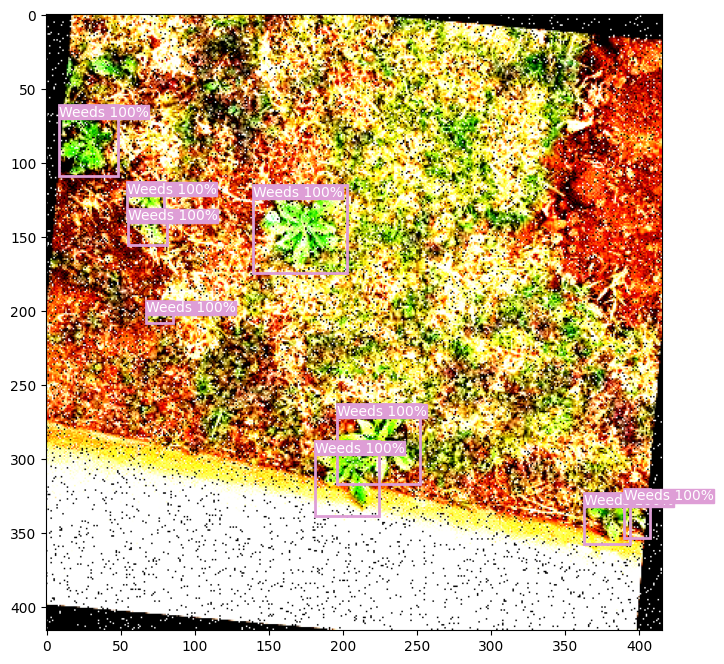

Image index:  819


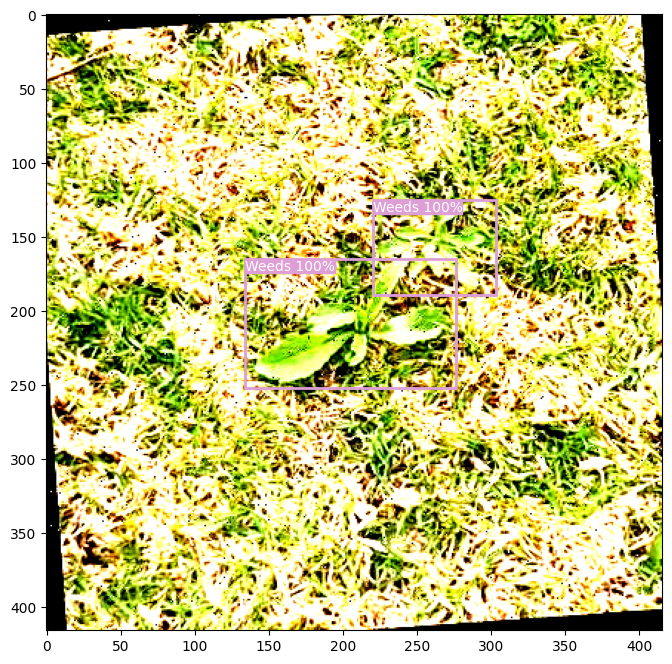

Image index:  341


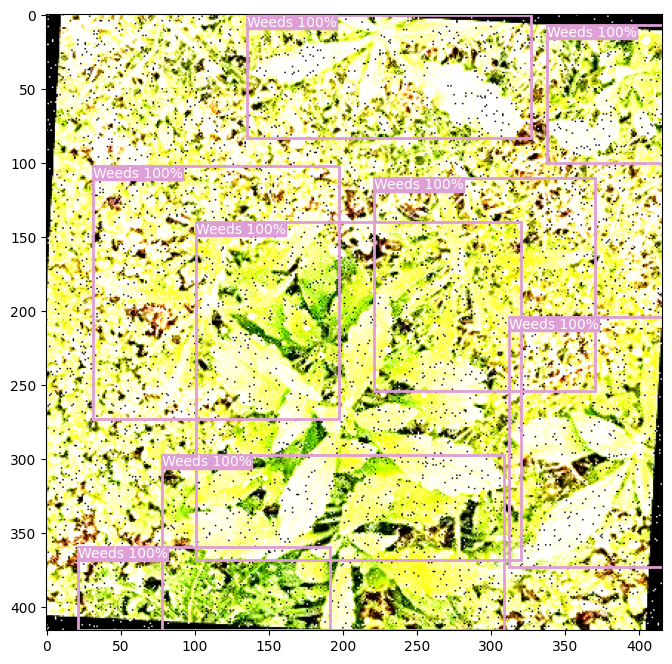

Image index:  539


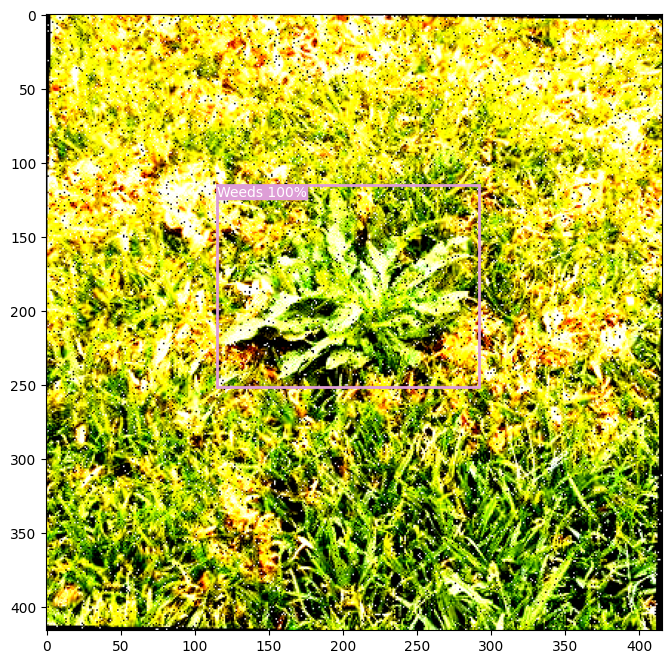

Image index:  844


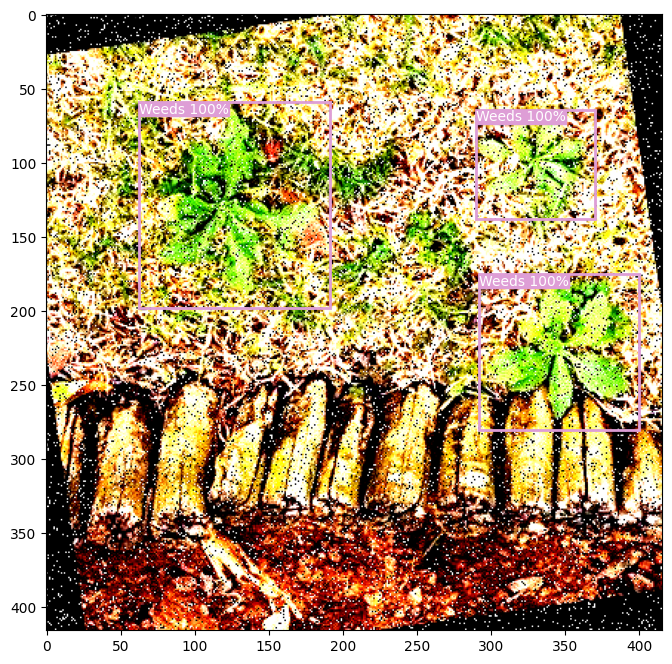

In [ ]:
crowdai = ["Background", "Weeds"]
dataset = vehicleDataset(img_dir, path_csv, crowdai, transforms=Transformation()) # here your arguments
num_images = 5

for _ in range(num_images):
  x = random.randint(0, (dataset.__len__()-1))
  img, target = dataset.__getitem__(x)
  img = img.cpu().permute(1,2,0).numpy()
  boxes = target['boxes'].numpy()
  labels = target['labels'].numpy()
  scores = [1]*len(labels)
  print("Image index: ", x)
  plot_image(img, boxes, scores, labels, crowdai)

# Hyperparameters

In [ ]:
# Hyperparameters

SEED = 42

TEST_SIZE = 0.2

NUM_EPOCHS = 15

LR = 0.005
LR_MOMENTUM=0.9
LR_DECAY_RATE=0.0005

LR_SCHED_STEP_SIZE = 0.1
LR_SCHED_GAMMA = 0.1

BATCH_SIZE = 16

NUM_TEST_IMAGES = 5
NMS_THRESH = 0.01

In [ ]:
current_dir = curren_dir if USE_COLAB else os.getcwd()

# Fetch current date and time
now = datetime.now()
dt_string = now.strftime("%d-%m-%Y-%H-%M-%S")
output_dir_name = "output-" + dt_string

OUTPUT_DIR = os.path.join(current_dir, output_dir_name)
os.makedirs(OUTPUT_DIR, exist_ok=True)

In [ ]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

model = torchvision.models.detection.fasterrcnn_resnet50_fpn(min_size=300, max_size=480, pretrained=True)
num_classes = 2  # 3 classes + background
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
model.to(device)

num_epochs = NUM_EPOCHS

# construct an optimizer
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=LR, momentum=LR_MOMENTUM, weight_decay=LR_DECAY_RATE)

# create a train- and validation-dataset with our vehicleDataset
# split the dataset in train and test set
dataset = vehicleDataset(img_dir, path_csv, crowdai, transforms=Transformation())      # here your arguments
dataset_test = vehicleDataset(img_dir, path_csv, crowdai, transforms=None)             # here your arguments

torch.manual_seed(SEED)
indices = torch.randperm(len(dataset)).tolist()

test_size = int(len(dataset) * TEST_SIZE)
dataset = torch.utils.data.Subset(dataset, indices[:-test_size])
dataset_test = torch.utils.data.Subset(dataset_test, indices[-test_size:])

# create a learning rate scheduler
# TODO: step size to be tuned !
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, \
                                                step_size=LR_SCHED_STEP_SIZE, \
                                                gamma=LR_SCHED_GAMMA)

def collate_fn(batch):
  return tuple(zip(*batch))

# define training and validation data loaders
data_loader = torch.utils.data.DataLoader(
  dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=2,
  collate_fn=collate_fn)

data_loader_test = torch.utils.data.DataLoader(
  dataset_test, batch_size=1, shuffle=False, num_workers=2,
  collate_fn=collate_fn)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Preparing the dataset...
Filtering the dataset...
Images removed with no labels:  2605
Images removed with incorrect bounding boxes:  0
Dataset prepared
Preparing the dataset...
Filtering the dataset...
Images removed with no labels:  2605
Images removed with incorrect bounding boxes:  0
Dataset prepared


In [ ]:
'''
Function to train the model over one epoch.
'''
def train_one_epoch(model, optimizer, data_loader, device, epoch):
  train_loss_list = []

  tqdm_bar = tqdm(data_loader, total=len(data_loader))
  for idx, data in enumerate(tqdm_bar):
    optimizer.zero_grad()
    images, targets = data

    images = list(image.to(device) for image in images)
    targets = [{k: v.to(device) for k, v in t.items()} for t in targets]  # targets = {'boxes'=tensor, 'labels'=tensor}

    losses = model(images, targets)

    loss = sum(loss for loss in losses.values())
    loss_val = loss.item()
    train_loss_list.append(loss.detach().cpu().numpy())

    loss.backward()
    optimizer.step()

    tqdm_bar.set_description(desc=f"Training Loss: {loss:.3f}")

  return train_loss_list

'''
Function to validate the model
'''
def evaluate(model, data_loader_test, device):
    val_loss_list = []

    tqdm_bar = tqdm(data_loader_test, total=len(data_loader_test))

    for i, data in enumerate(tqdm_bar):
        images, targets = data

        images = list(image.to(device) for image in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        with torch.no_grad():
            losses = model(images, targets)

        loss = sum(loss for loss in losses.values())
        loss_val = loss.item()
        val_loss_list.append(loss_val)

        tqdm_bar.set_description(desc=f"Validation Loss: {loss:.4f}")
    return val_loss_list

'''
Function to plot training and valdiation losses and save them in `output_dir'
'''
def plot_loss(train_loss, valid_loss):
    figure_1, train_ax = plt.subplots()
    figure_2, valid_ax = plt.subplots()

    train_ax.plot(train_loss, color='blue')
    train_ax.set_xlabel('Iteration')
    train_ax.set_ylabel('Training Loss')

    valid_ax.plot(valid_loss, color='red')
    valid_ax.set_xlabel('Iteration')
    valid_ax.set_ylabel('Validation loss')

    figure_1.savefig(f"{OUTPUT_DIR}/train_loss.png")
    figure_2.savefig(f"{OUTPUT_DIR}/valid_loss.png")

In [ ]:
print("HOLA")

HOLA


In [ ]:
print(len(data_loader))

54


# Training

In [ ]:
# find latest saved chcekpoint
checkpoint_files = [f for f in os.listdir(OUTPUT_DIR) if f.endswith('.pth')]
if checkpoint_files:
    # Last ckpt file
    checkpoint_files.sort()
    latest_checkpoint = os.path.join(OUTPUT_DIR, checkpoint_files[-1])

    # Load the ckpt
    checkpoint = torch.load(latest_checkpoint)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    start_epoch = checkpoint['epoch']
    loss_dict = checkpoint['loss_dict']
else:
    start_epoch = 0
    loss_dict = {'train_loss': [], 'valid_loss': []}

'''
Train the model over all epochs
'''
for epoch in range(start_epoch, num_epochs):
  print("----------Epoch {}----------".format(epoch+1))

  # Train the model for one epoch
  train_loss_list = train_one_epoch(model, optimizer, data_loader, device, epoch)
  loss_dict['train_loss'].extend(train_loss_list)

  lr_scheduler.step()

  # Run evaluation
  valid_loss_list = evaluate(model, data_loader_test, device)
  loss_dict['valid_loss'].extend(valid_loss_list)

  # Svae the model ckpt after every epoch
  ckpt_file_name = f"{OUTPUT_DIR}/epoch_{epoch+1}_model.pth"
  torch.save({
    'epoch': epoch+1,
    'model_state_dict': model.state_dict(),
    'optimizer_state_dict': optimizer.state_dict(),
    'loss_dict': loss_dict
  }, ckpt_file_name)

  # NOTE: The losses are accumulated over all iterations
  plot_loss(loss_dict['train_loss'], loss_dict['valid_loss'])

# Store the losses after the training in a pickle
with open(f"{OUTPUT_DIR}/loss_dict.pkl", "wb") as file:
    pickle.dump(loss_dict, file)

print("Training Finished !")

#Testing


## Simple Test

[[  2 282  88 355]
 [ 12  14 338 330]
 [352 306 403 362]
 [352 284 410 391]
 [ 48 318  86 368]
 [159 178 287 302]] [0.99814427 0.9975056  0.89288634 0.14038284 0.06038145 0.05085759] [1 1 1 1 1 1]


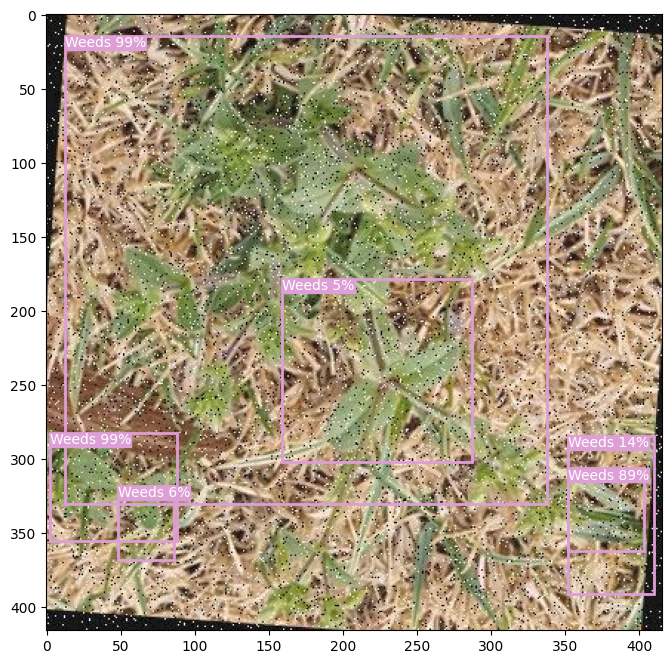

[[124  91 327 310]] [0.9996282] [1]


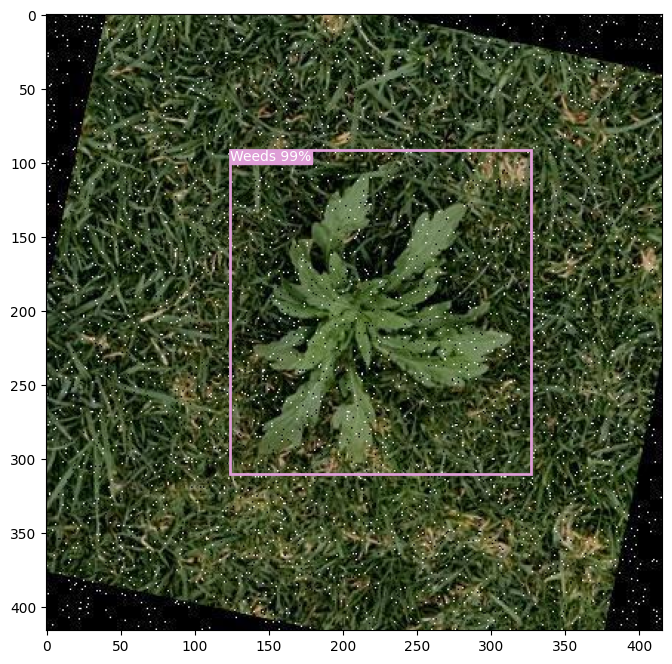

[[246 274 295 309]
 [231 201 275 240]
 [147 184 222 239]
 [251 281 285 305]
 [155 183 275 253]
 [247 271 283 298]
 [263 285 297 309]] [0.9339871  0.7840012  0.7248188  0.4464158  0.1820813  0.16619153
 0.0996673 ] [1 1 1 1 1 1 1]


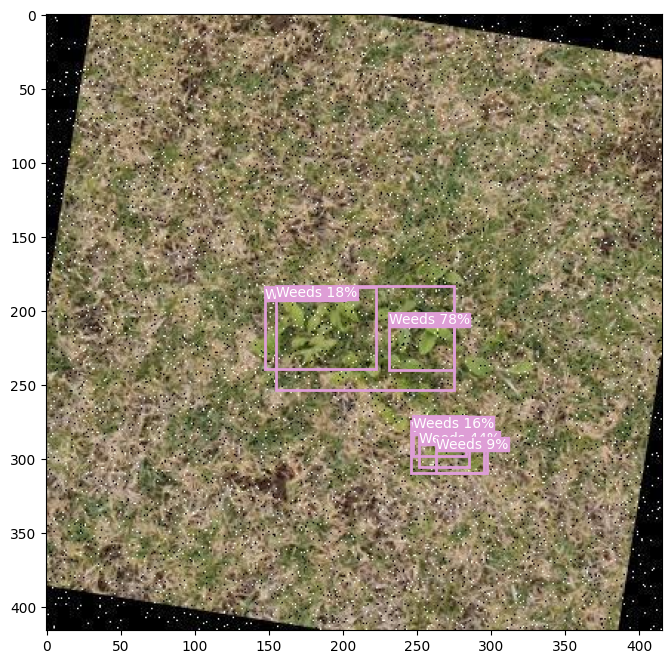

[[297 172 416 334]
 [ 92  12 246 131]
 [101 144 320 384]
 [188 141 308 260]
 [188 318 286 401]
 [162 272 301 412]
 [188  63 250 115]
 [118 315 185 379]
 [207 334 262 395]
 [262  51 325 112]
 [  6 244  27 323]
 [373 324 410 362]
 [165 125 319 314]
 [  4 233  36 359]
 [264  72 311 112]
 [  7 252  27 294]] [0.99963224 0.9991037  0.99083835 0.8097425  0.57097024 0.37807056
 0.26001552 0.25226805 0.20887727 0.1928757  0.1574302  0.12787879
 0.11123867 0.07947803 0.06893399 0.06305578] [1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]


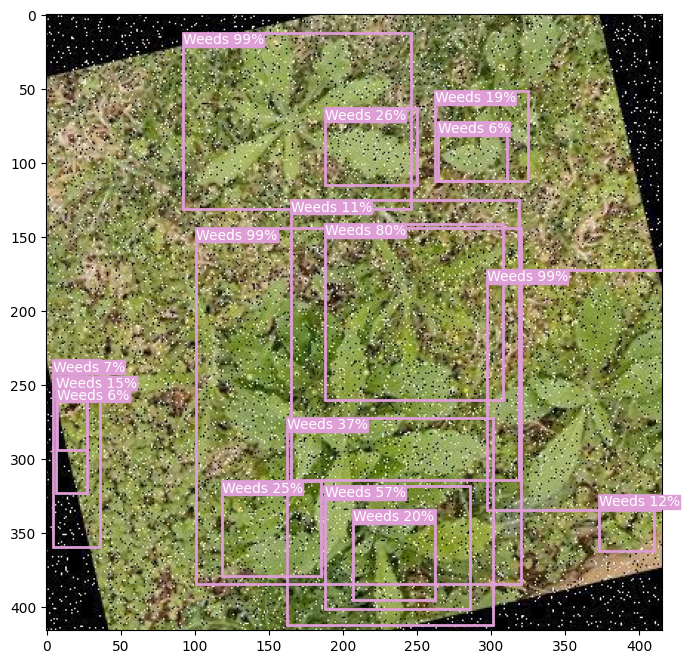

[[313 261 414 381]] [0.9989543] [1]


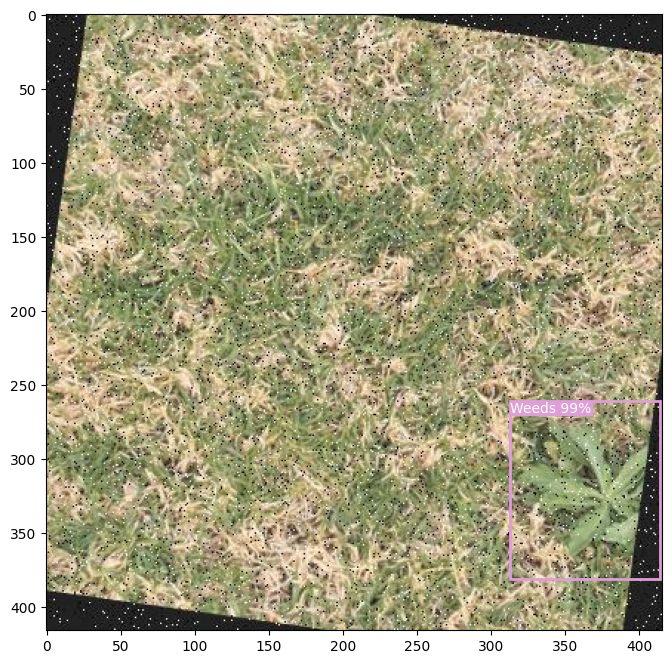

In [ ]:
random.seed(SEED)
crowdai = ["Background",'Weeds']
num_images = NUM_TEST_IMAGES

for _ in range(num_images):
  x = random.randint(0, (dataset_test.__len__()-1))
  img, target = dataset_test.__getitem__(x)
  img = img.to(device)

  # Load last checkpoint
  # CHANGE THE OUTPUT_DIR IF CKPT IS STORED ELSEWHERE
  checkpoint_dir = f"/{OUTPUT_DIR}/epoch_15_model.pth"
  checkpoint = torch.load(checkpoint_dir, map_location=device)
  model.load_state_dict(checkpoint['model_state_dict'])

  boxes, scores, labels = inference(img, model)
  print(boxes,scores,labels)
  img = img.squeeze(0).cpu().permute(1,2,0).numpy()
  plot_image(img, boxes, scores, labels, crowdai, save_path=f"{OUTPUT_DIR}/inference_{x}.png")

[[149 177 280 258]
 [144 183 225 242]
 [255 278 297 308]
 [217 195 275 247]] [0.8742007  0.45789948 0.2040764  0.05865612] [1 1 1 1]


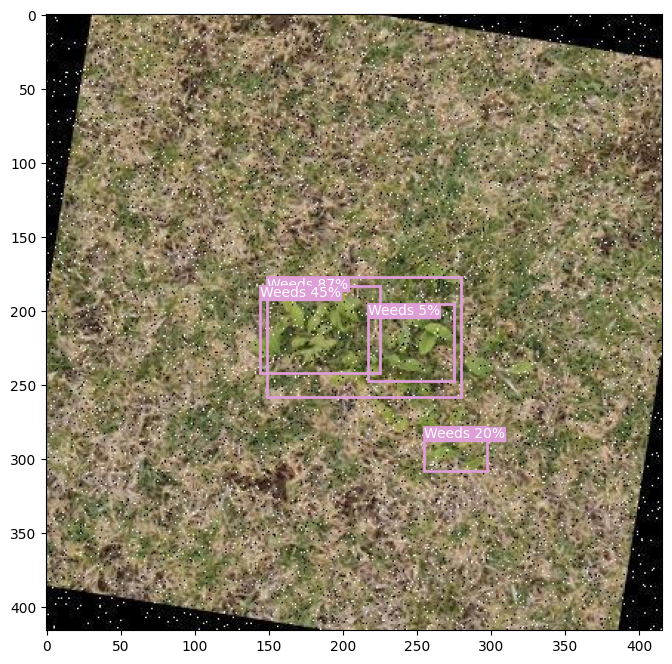

[[157 156 269 265]] [0.99361515] [1]


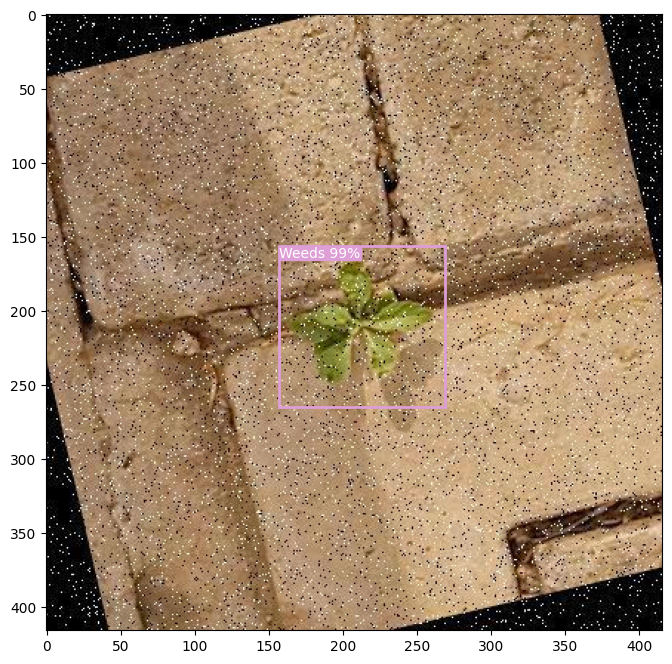

[[160 146 327 298]
 [361 242 414 413]
 [353 391 379 415]] [0.97371167 0.17275125 0.05569648] [1 1 1]


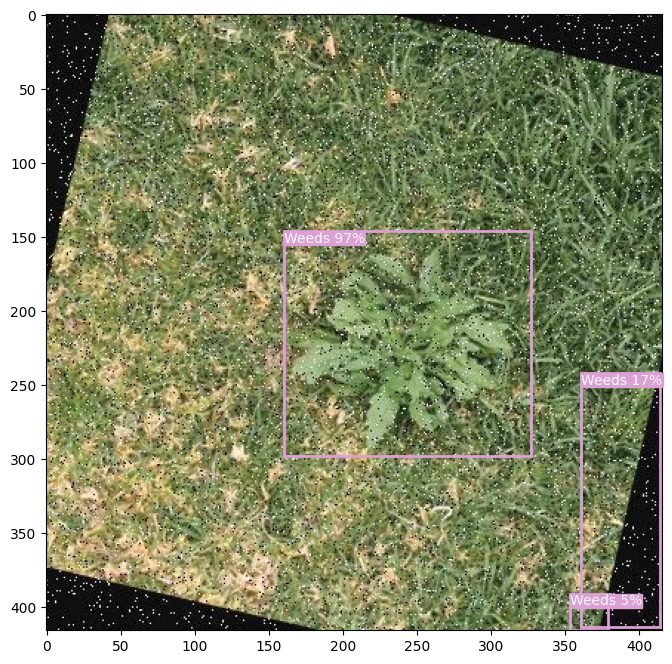

[[199 255 313 365]
 [205 163 297 228]
 [261 342 326 397]
 [302 263 392 347]
 [267 340 317 378]
 [ 34   6 151  96]
 [ 32 358  67 391]
 [370 305 412 348]
 [305 162 355 216]
 [370 325 408 354]
 [381 307 414 337]
 [215 283 333 398]
 [365 303 402 329]
 [265 317 343 390]
 [309 347 332 379]
 [240 255 387 365]
 [  5 317  69 409]
 [356 285 397 327]
 [312 346 347 376]
 [297 374 328 400]
 [315 288 410 361]
 [402 304 415 339]
 [352 321 398 365]
 [352 318 382 346]
 [ 13 343  66 395]
 [352 307 387 331]
 [346 272 406 338]
 [365 262 412 351]
 [279 371 327 403]
 [365 321 394 351]
 [364 313 404 338]
 [282 295 372 371]
 [338 328 382 369]
 [236 307 382 400]
 [289 340 338 380]
 [350 301 393 345]
 [227 359 331 411]
 [319 335 367 376]
 [393 300 415 333]] [0.99152935 0.98888516 0.82953346 0.7997679  0.7700888  0.6004672
 0.5440924  0.43873054 0.42552873 0.4245726  0.34020063 0.23701276
 0.23265424 0.21192072 0.21127401 0.19932203 0.19420828 0.18341772
 0.16082977 0.15627526 0.14415357 0.12542734 0.12018695 0.

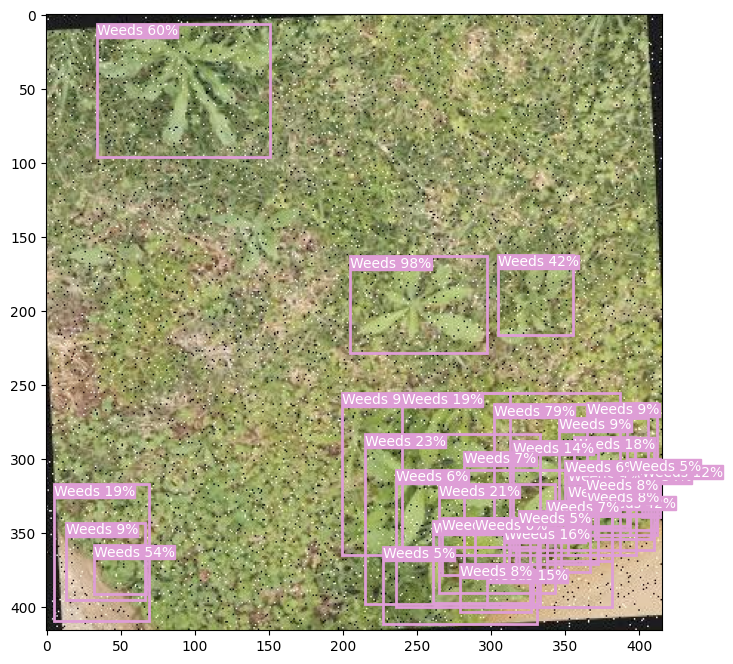

[[179  66 375 245]] [0.9955706] [1]


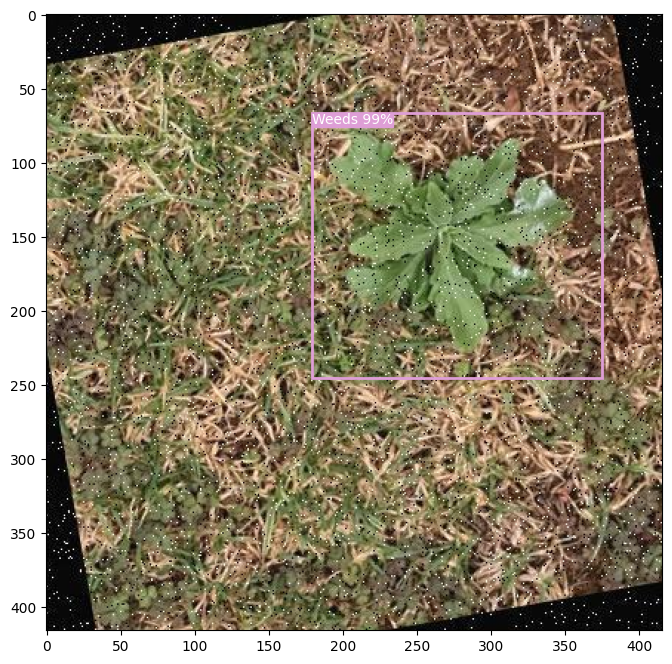

In [ ]:
random.seed(SEED)
crowdai = ["Background",'Weeds']
num_images = NUM_TEST_IMAGES

for _ in range(num_images):
  x = random.randint(0, (dataset_test.__len__()-1))
  img, target = dataset_test.__getitem__(x)
  img = img.to(device)

  # Load last checkpoint
  # CHANGE THE OUTPUT_DIR IF CKPT IS STORED ELSEWHERE
  checkpoint_dir = f"/{OUTPUT_DIR}/epoch_10_model.pth"
  checkpoint = torch.load(checkpoint_dir, map_location=device)
  model.load_state_dict(checkpoint['model_state_dict'])

  boxes, scores, labels = inference(img, model)
  print(boxes,scores,labels)
  img = img.squeeze(0).cpu().permute(1,2,0).numpy()
  plot_image(img, boxes, scores, labels, crowdai, save_path=f"{OUTPUT_DIR}/inference_{x}.png")

[[137.0, 114.0, 309.0, 284.0]]
1
[[144 127 309 276]]
1
Scores(IoU):  [0.9782864]
> Tresh [[144 127 309 276]]


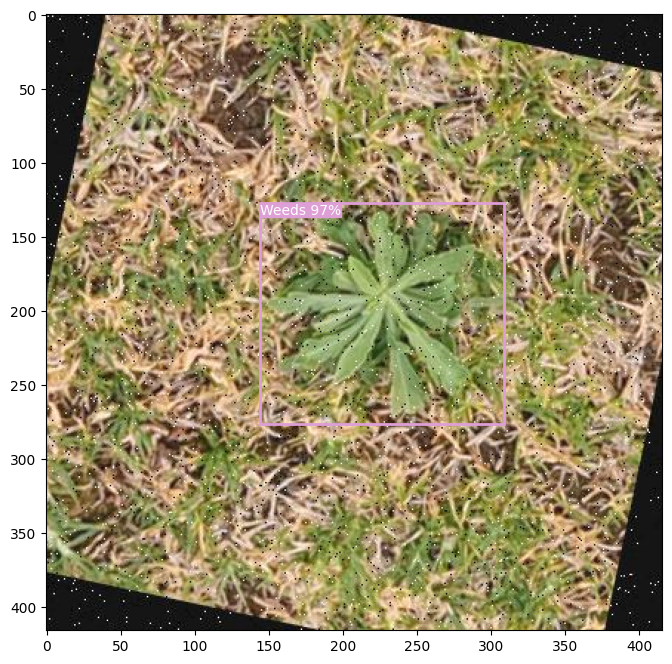

[[105.0, 198.0, 189.0, 267.0], [141.0, 152.0, 282.0, 250.0]]
2
[[113 160 287 253]
 [166 166 287 227]
 [106 176 221 262]
 [211 168 281 211]]
4
Scores(IoU):  [0.91885644 0.693262   0.6625966  0.5865937 ]
> Tresh [[113 160 287 253]]


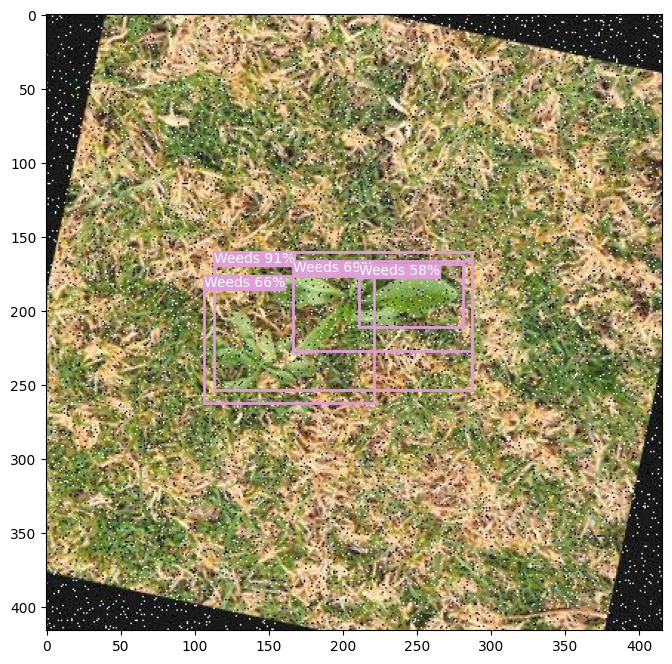

[[124.0, 163.0, 215.0, 270.0]]
1
[[127 178 229 264]
 [141 196 212 256]]
2
Scores(IoU):  [0.88907146 0.56524676]
> Tresh [[127 178 229 264]]


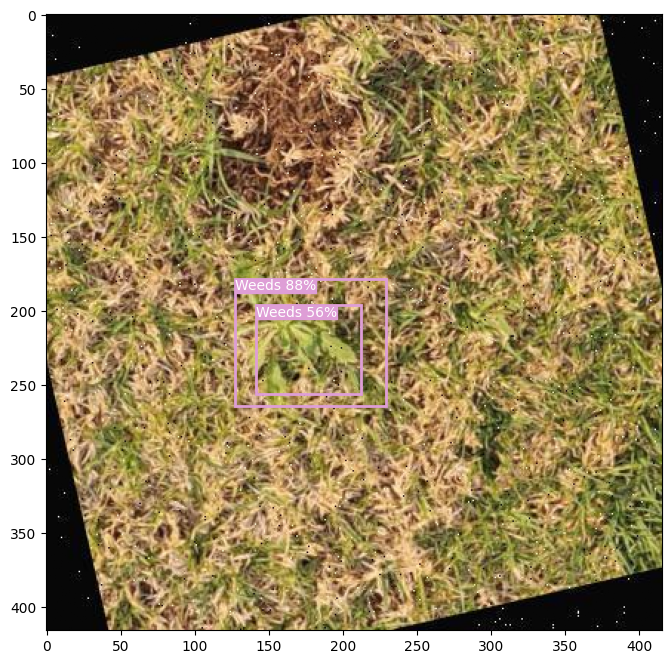

In [ ]:
import random
random.seed(SEED)
crowdai = ["Background",'Weeds']
num_images = 3 #NUM_TEST_IMAGES
TP=[]
FP=[]
FN=[]
Confidence=[]
Tresh=0.75
for _ in range(num_images):
  x = random.randint(0, (dataset_test.__len__()-1))
  img, target = dataset_test.__getitem__(x)
  teorBoundB=target['boxes'].tolist()
  print(teorBoundB)
  TeornumofBoxes=len(teorBoundB)
  print(TeornumofBoxes)
  img = img.to(device)

  # Load last checkpoint
  # CHANGE THE OUTPUT_DIR IF CKPT IS STORED ELSEWHERE
  output_dir_name='output-31-05-2024-16-08-27'
  OUTPUT_DIR=os.path.join(current_dir, output_dir_name)
  checkpoint_dir = f"/{OUTPUT_DIR}/epoch_3_model.pth"
  checkpoint = torch.load(checkpoint_dir, map_location=device)
  model.load_state_dict(checkpoint['model_state_dict'])

  boxes, scores, labels = inference(img, model)

  print(boxes)
  detecnumboxes=len(boxes)
  print(detecnumboxes)
  print('Scores(IoU): ',scores)
  Confidence.append(scores)
  print("> Tresh",boxes[scores>Tresh])
  for box in boxes[scores>Tresh]:
    TP.append(1)
    FP.append(0)
    FN.append(TeornumofBoxes)

  for box in boxes[scores<Tresh]:
    FP.append(1)
    TP.append(0)
    FN.append(TeornumofBoxes)






  img = img.squeeze(0).cpu().permute(1,2,0).numpy()
  plot_image(img, boxes, scores, labels, crowdai, save_path=f"{OUTPUT_DIR}/inference_{x}.png")